In [86]:
import glob

import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import pandas as pd
import metpy

from tqdm.notebook import tqdm

In [87]:
xr.set_options(keep_attrs=True)

In [3]:
dates = pd.date_range(start='2021-01-01', end='2022-01-01', freq='1d', inclusive="left", tz='GMT').values
files = {}
for i in dates:
    date = f'{pd.to_datetime(i).dayofyear:03}'
    files[date] = sorted(glob.glob(f'/Volumes/Shores/GOES/AODC/averages/2021/{date}/*.nc'))

In [4]:
with xr.open_dataset(files['001'][14]) as aod:
    aod.load()

In [5]:
geo = aod.metpy.parse_cf('AOD').metpy.cartopy_crs
plate = ccrs.PlateCarree()

In [6]:
columns=['latitude', 'longitude', 'sample_measurement', 'units_of_measure', 'poc', 'sample_frequency', 'time']
dfs = [pd.read_csv(i, usecols=columns, parse_dates=['time']) for i in glob.glob('/Users/kyle/Documents/PM25-US/data/PM/*.csv')]

In [7]:
df = pd.concat(dfs, axis=0)

In [8]:
df

,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,time
0,33.778400,-84.391400,6.7,Micrograms/cubic meter (LC),1,EVERY 3RD DAY,2021-01-01 05:00:00+00:00
1,33.778400,-84.391400,6.8,Micrograms/cubic meter (LC),1,EVERY 3RD DAY,2021-01-04 05:00:00+00:00
2,33.778400,-84.391400,9.7,Micrograms/cubic meter (LC),1,EVERY 3RD DAY,2021-01-07 05:00:00+00:00
3,33.778400,-84.391400,14.3,Micrograms/cubic meter (LC),1,EVERY 3RD DAY,2021-01-10 05:00:00+00:00
4,33.778400,-84.391400,13.6,Micrograms/cubic meter (LC),1,EVERY 3RD DAY,2021-01-13 05:00:00+00:00
...,...,...,...,...,...,...,...
35155,38.921847,-77.013178,5.0,Micrograms/cubic meter (LC),1,HOURLY,2021-01-01 09:00:00+00:00
35156,38.921847,-77.013178,4.0,Micrograms/cubic meter (LC),1,HOURLY,2021-01-01 08:00:00+00:00
35157,38.921847,-77.013178,9.0,Micrograms/cubic meter (LC),1,HOURLY,2021-01-01 07:00:00+00:00
35158,38.921847,-77.013178,12.0,Micrograms/cubic meter (LC),1,HOURLY,2021-01-01 06:00:00+00:00


In [9]:
df.groupby('sample_frequency').count()

,latitude,longitude,sample_measurement,units_of_measure,poc,time
sample_frequency,,,,,,
DAILY: 24 - 1 HR SAMPLES -PAMS,8760,8760,8569,8760,8760,8760
EVERY 12TH DAY,10772,10772,10147,10772,10772,10772
EVERY 3RD DAY,64429,64429,60363,64429,64429,64429
EVERY 6TH DAY,12441,12441,11359,12441,12441,12441
EVERY DAY,30293,30293,27937,30293,30293,30293
HOURLY,6446239,6446239,6166859,6446239,6446239,6446239


In [10]:
df = df[df.sample_frequency == 'HOURLY']
df = df.sort_values(by='time').set_index('time')

In [11]:
locations = df[['latitude', 'longitude']].drop_duplicates().reset_index(drop=True)

In [15]:
import cartopy.io.img_tiles as cimgt

In [16]:
dir(cimgt)

['ABCMeta',
 'AzureMapsTiles',
 'GoogleTiles',
 'GoogleWTS',
 'Image',
 'MapQuestOSM',
 'MapQuestOpenAerial',
 'MapboxStyleTiles',
 'MapboxTiles',
 'OSM',
 'OrdnanceSurvey',
 'QuadtreeTiles',
 'Stamen',
 'StamenTerrain',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__spec__',
 '_merge_tiles',
 'abstractmethod',
 'cartopy',
 'ccrs',
 'concurrent',
 'io',
 'np',
 'os',
 'sgeom',
 'warnings']

In [37]:
import geoviews as gv
from geoviews import opts

In [59]:
ccrs.Mercator()

<Derived Projected CRS: +proj=merc +ellps=WGS84 +lon_0=0.0 +x_0=0.0 +y_0=0 ...>
Name: unknown
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unknown
- method: Mercator (variant A)
Datum: Unknown based on WGS84 ellipsoid
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
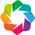

In [24]:
gv.extension('bokeh')

In [73]:
tiles = gv.tile_sources.EsriImagery()

In [74]:
tiles

:WMTS   [Longitude,Latitude]

In [79]:
tiles * gv.Points(locations.sample(20)[['longitude', 'latitude']].values).opts(color='red', width=400)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]

In [83]:
locations.sample(20)[['longitude', 'latitude']].values

array([[ -86.21487 ,   37.04926 ],
       [ -83.344385,   33.918137],
       [ -75.6106  ,   38.6539  ],
       [-122.633579,   41.726892],
       [-122.480487,   43.744352],
       [ -82.53532 ,   37.4826  ],
       [-100.76821 ,   46.825425],
       [-119.8284  ,   34.44551 ],
       [ -71.423705,   41.49511 ],
       [-109.455315,   47.048537],
       [ -98.391403,   29.529432],
       [ -90.160477,   38.612034],
       [ -77.54817 ,   43.14618 ],
       [ -84.36625 ,   39.2787  ],
       [ -80.420833,   40.445278],
       [ -95.38769 ,   29.81453 ],
       [-112.00264 ,   33.41046 ],
       [ -80.243995,   40.268963],
       [ -80.80116 ,   41.23172 ],
       [ -79.863572,   40.43743 ]])

In [19]:
fig, ax = plt.subplots(dpi=300, subplot_kw={'projection': geo})

# ax.set_extent((-180, -60, 0, 90), crs=plate)
# ax.set_extent((-180, -60, 0, 65), crs=plate)

ax.scatter(locations.longitude, locations.latitude, 
           s=1, 
           alpha=0.3, 
           color='red', 
           transform=plate)

# https://apps.nationalmap.gov/services/
# ax.add_wms(wms='https://basemap.nationalmap.gov/arcgis/services/USGSImageryTopo/MapServer/WMSServer',
#                layers=['0'])

# ax.add_wms(wms='https://basemap.nationalmap.gov/arcgis/services/USGSShadedReliefOnly/MapServer/WMSServer',
#                layers=['0'])

# https://neo.gsfc.nasa.gov/wms/wms?version=1.3.0&service=WMS&request=GetCapabilities
# ax.add_wms(wms='https://neo.gsfc.nasa.gov/wms/wms?version=1.3.0&service=WMS',
#                layers=['BlueMarbleNG'])

# ax.add_wms(wms='https://services.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer',
#                layers=['World Imagery'])

# https://vmap0.tiles.osgeo.org/wms/vmap0?request=GetCapabilities&service=WMS
# ax.add_wms(wms='http://vmap0.tiles.osgeo.org/wms/vmap0',
#                layers=['population'])

ax.add_image(cimgt.OSM(), 10)

gl = ax.gridlines(draw_labels=True, alpha=0.4)
gl.top_labels = False
gl.right_labels = False
ax.spines['geo'].set_visible(False)

HTTP Error 404: Not Found
HTTP Error 404: Not Found
HTTP Error 404: Not Found
HTTP Error 404: Not Found
HTTP Error 404: Not Found
HTTP Error 404: Not Found
Error in callback <function flush_figures at 0x1a179bd90> (for post_execute):


KeyboardInterrupt: 

In [15]:
transformed = geo.transform_points(src_crs=plate, x=df['longitude'], y=df['latitude'])
df['proj_longitude'] = transformed[:,0]
df['proj_latitude'] = transformed[:,1]

In [18]:
locations2 = df[['proj_latitude', 'proj_longitude']].drop_duplicates().reset_index(drop=True)

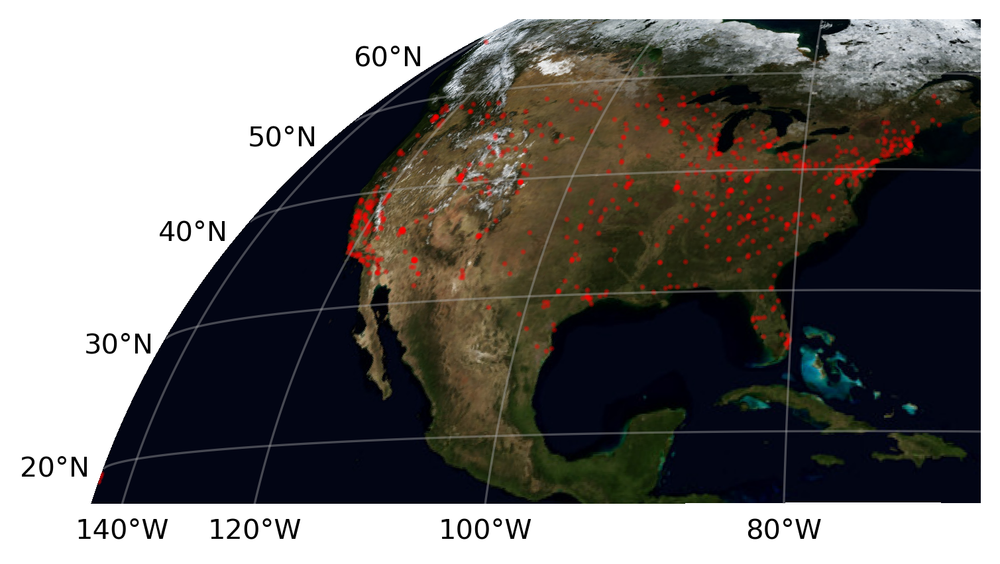

In [19]:
fig, ax = plt.subplots(dpi=300, subplot_kw={'projection': geo})

# ax.set_extent((-180, -60, 0, 90), crs=plate)
# ax.set_extent((-180, -60, 0, 65), crs=plate)

ax.scatter(locations2.proj_longitude, locations2.proj_latitude, 
           s=1, 
           alpha=0.3, 
           color='red', 
           transform=geo)

# https://neo.gsfc.nasa.gov/wms/wms?version=1.3.0&service=WMS&request=GetCapabilities
ax.add_wms(wms='https://neo.gsfc.nasa.gov/wms/wms?version=1.3.0&service=WMS',
               layers=['BlueMarbleNG'])

gl = ax.gridlines(draw_labels=True, alpha=0.4)
gl.top_labels = False
gl.right_labels = False
ax.spines['geo'].set_visible(False)

In [20]:
df

,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude
time,,,,,,,,
2021-01-01 05:00:00+00:00,38.921847,-77.013178,17.0,Micrograms/cubic meter (LC),1,HOURLY,-1.669656e+05,3.819667e+06
2021-01-01 05:00:00+00:00,26.294167,-80.176389,11.7,Micrograms/cubic meter (LC),3,HOURLY,-5.050985e+05,2.750557e+06
2021-01-01 05:00:00+00:00,40.603943,-74.276174,25.0,Micrograms/cubic meter (LC),3,HOURLY,5.839372e+04,3.943872e+06
2021-01-01 05:00:00+00:00,39.485987,-87.401312,19.1,Micrograms/cubic meter (LC),4,HOURLY,-1.008125e+06,3.850257e+06
2021-01-01 05:00:00+00:00,40.246992,-76.846988,15.2,Micrograms/cubic meter (LC),7,HOURLY,-1.498771e+05,3.917736e+06
...,...,...,...,...,...,...,...,...
2022-01-01 09:00:00+00:00,19.555444,-155.102028,4.0,Micrograms/cubic meter (LC),1,HOURLY,-5.111458e+06,1.844094e+06
2022-01-01 09:00:00+00:00,20.869627,-156.493626,15.0,Micrograms/cubic meter (LC),1,HOURLY,NaN,NaN
2022-01-01 09:00:00+00:00,21.307580,-157.855420,7.0,Micrograms/cubic meter (LC),3,HOURLY,NaN,NaN


In [21]:
# drop locations that are not observable by GOES-16
df = df.dropna()

In [22]:
df = df[df.sample_measurement >= 0]
empty = np.empty(df.shape[0])
empty[:] = np.nan
df['AOD'] = empty

In [23]:
df

,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
time,,,,,,,,,
2021-01-01 05:00:00+00:00,38.921847,-77.013178,17.0,Micrograms/cubic meter (LC),1,HOURLY,-1.669656e+05,3.819667e+06,NaN
2021-01-01 05:00:00+00:00,26.294167,-80.176389,11.7,Micrograms/cubic meter (LC),3,HOURLY,-5.050985e+05,2.750557e+06,NaN
2021-01-01 05:00:00+00:00,40.603943,-74.276174,25.0,Micrograms/cubic meter (LC),3,HOURLY,5.839372e+04,3.943872e+06,NaN
2021-01-01 05:00:00+00:00,39.485987,-87.401312,19.1,Micrograms/cubic meter (LC),4,HOURLY,-1.008125e+06,3.850257e+06,NaN
2021-01-01 05:00:00+00:00,40.246992,-76.846988,15.2,Micrograms/cubic meter (LC),7,HOURLY,-1.498771e+05,3.917736e+06,NaN
...,...,...,...,...,...,...,...,...,...
2022-01-01 08:00:00+00:00,19.717562,-155.110530,22.0,Micrograms/cubic meter (LC),1,HOURLY,-5.106190e+06,1.858675e+06,NaN
2022-01-01 09:00:00+00:00,19.203900,-155.480183,27.0,Micrograms/cubic meter (LC),1,HOURLY,-5.123694e+06,1.810613e+06,NaN
2022-01-01 09:00:00+00:00,19.717562,-155.110530,15.0,Micrograms/cubic meter (LC),1,HOURLY,-5.106190e+06,1.858675e+06,NaN


In [24]:
df = df.reset_index().set_index(['time', 'latitude', 'longitude'])

In [25]:
df

sample_measurement  \
time                      latitude  longitude                         
2021-01-01 05:00:00+00:00 38.921847 -77.013178                 17.0   
                          26.294167 -80.176389                 11.7   
                          40.603943 -74.276174                 25.0   
                          39.485987 -87.401312                 19.1   
                          40.246992 -76.846988                 15.2   
...                                                             ...   
2022-01-01 08:00:00+00:00 19.717562 -155.110530                22.0   
2022-01-01 09:00:00+00:00 19.203900 -155.480183                27.0   
                          19.717562 -155.110530                15.0   
                          19.430800 -155.257800                 2.0   
                          19.555444 -155.102028                 4.0   

                                                            units_of_measure  \
time                      latitude  longitude                                  
2021-01-01 05:00:00+00:00 38.921847 -77.013178   Micrograms/cubic meter (LC)   
                          26.294167 -80.176389   Micrograms/cubic meter (LC)   
                          40.603943 -74.276174   Micrograms/cubic meter (LC)   
                          39.485987 -87.401312   Micrograms/cubic meter (LC)   
                          40.246992 -76.846988   Micrograms/cubic meter (LC)   
...                                                                      ...   
2022-01-01 08:00:00+00:00 19.717562 -155.110530  Micrograms/cubic meter (LC)   
2022-01-01 09:00:00+00:00 19.203900 -155.480183  Micrograms/cubic meter (LC)   
                          19.717562 -155.110530  Micrograms/cubic meter (LC)   
                          19.430800 -155.257800  Micrograms/cubic meter (LC)   
                          19.555444 -155.102028  Micrograms/cubic meter (LC)   

                                                 poc sample_frequency  \
time                      latitude  longitude                           
2021-01-01 05:00:00+00:00 38.921847 -77.013178     1           HOURLY   
                          26.294167 -80.176389     3           HOURLY   
                          40.603943 -74.276174     3           HOURLY   
                          39.485987 -87.401312     4           HOURLY   
                          40.246992 -76.846988     7           HOURLY   
...                                              ...              ...   
2022-01-01 08:00:00+00:00 19.717562 -155.110530    1           HOURLY   
2022-01-01 09:00:00+00:00 19.203900 -155.480183    1           HOURLY   
                          19.717562 -155.110530    1           HOURLY   
                          19.430800 -155.257800    1           HOURLY   
                          19.555444 -155.102028    1           HOURLY   

                                                 proj_longitude  \
time                      latitude  longitude                     
2021-01-01 05:00:00+00:00 38.921847 -77.013178    -1.669656e+05   
                          26.294167 -80.176389    -5.050985e+05   
                          40.603943 -74.276174     5.839372e+04   
                          39.485987 -87.401312    -1.008125e+06   
                          40.246992 -76.846988    -1.498771e+05   
...                                                         ...   
2022-01-01 08:00:00+00:00 19.717562 -155.110530   -5.106190e+06   
2022-01-01 09:00:00+00:00 19.203900 -155.480183   -5.123694e+06   
                          19.717562 -155.110530   -5.106190e+06   
                          19.430800 -155.257800   -5.115901e+06   
                          19.555444 -155.102028   -5.111458e+06   

                                                 proj_latitude  AOD  
time                      latitude  longitude                        
2021-01-01 05:00:00+00:00 38.921847 -77.013178    3.819667e+06  NaN  
                          26.294167 -80.176389    2.

In [26]:
df.AOD.describe()

count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: AOD, dtype: float64

In [27]:
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

for k, vs in files.items():
    ds = xr.open_mfdataset(
        vs,
        concat_dim="t", 
        parallel=True, 
        combine='nested',
        data_vars='different',
    ).compute()
    sat_h = ds.goes_imager_projection.perspective_point_height
    ds = ds.assign_coords(x=ds.x*sat_h, y = ds.y*sat_h)
    
    start, end = map(lambda x: pd.to_datetime(x).strftime('%Y-%m-%d %H:%M:%S'), ds.t[[0, -1]].values)
    sub = df.loc[start:end]
    for (time, lat, lon), row in sub.iterrows():
        time = pd.to_datetime(time).strftime('%Y-%m-%d %H:%M:%S')
        try:
            data = ds.sel(
                x=row.proj_longitude, 
                y=row.proj_latitude, 
                t=time,
                method='nearest', 
                tolerance=2000
            )
            if np.isfinite(data.AOD).any():
                break
                df.loc[(time, lat, lon), 'AOD'] = data.AOD.item()
        except:
            pass
    break

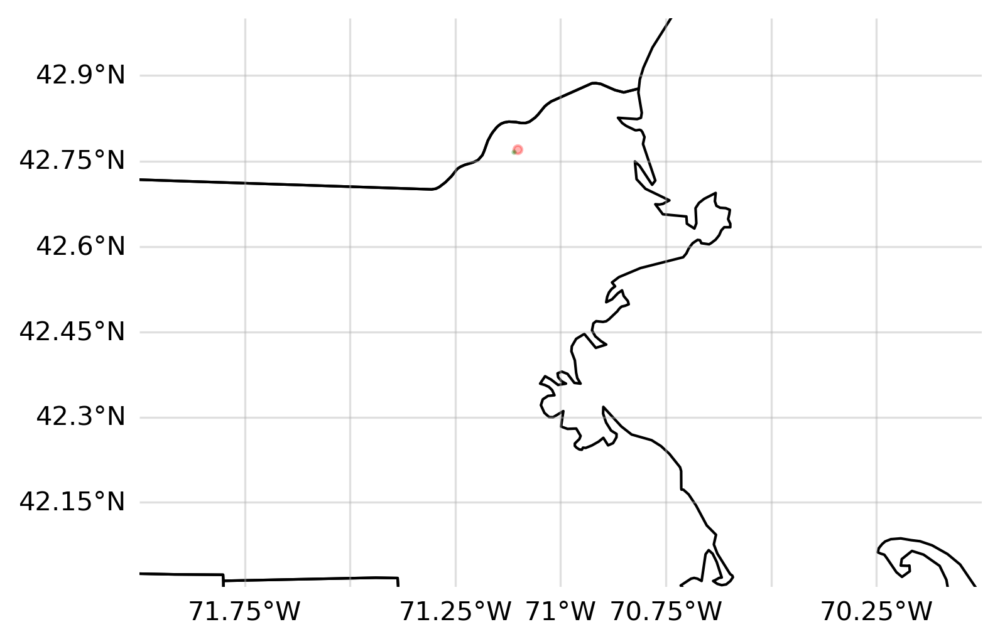

In [50]:
import cartopy.feature as cfeature

fig, ax = plt.subplots(dpi=300, subplot_kw={'projection': ccrs.Mercator()})

ax.set_extent((-72, -70, 42, 43), crs=plate)

ax.scatter(row.proj_longitude, row.proj_latitude, 
           s=10, 
           alpha=0.3, 
           color='red', 
           transform=geo)

ax.scatter(data.x, data.y, 
           s=1, 
           alpha=0.3, 
           color='green', 
           transform=geo)

ax.add_feature(cfeature.STATES)

gl = ax.gridlines(draw_labels=True, alpha=0.4)
gl.top_labels = False
gl.right_labels = False
ax.spines['geo'].set_visible(False)

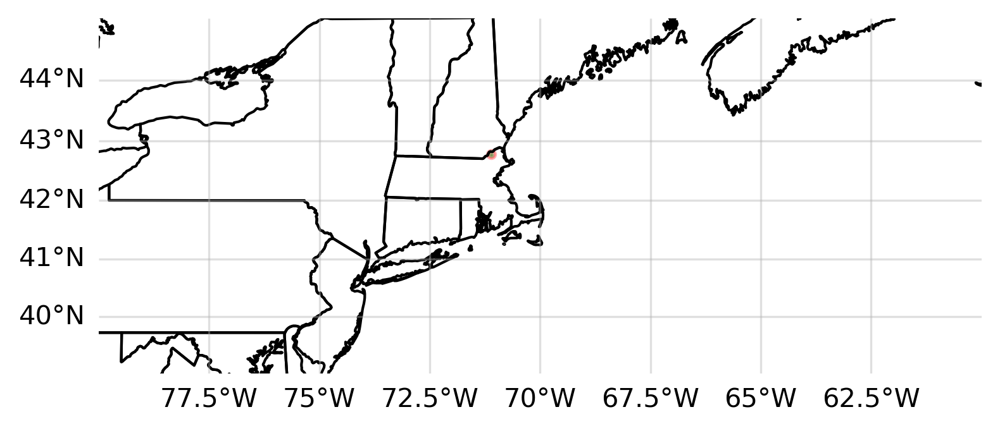

In [49]:
import cartopy.feature as cfeature

fig, ax = plt.subplots(dpi=300, subplot_kw={'projection': ccrs.Mercator()})

# ax.set_extent((-180, -60, 0, 90), crs=plate)
# ax.set_extent((-72, -70, 42, 43), crs=plate)
ax.set_extent((-80, -60, 39, 45), crs=plate)

ax.scatter(row.proj_longitude, row.proj_latitude, 
           s=10, 
           alpha=0.3, 
           color='red', 
           transform=geo)

ax.scatter(data.x, data.y, 
           s=1, 
           alpha=0.3, 
           color='green', 
           transform=geo)

ax.add_feature(cfeature.STATES)

gl = ax.gridlines(draw_labels=True, alpha=0.4)
gl.top_labels = False
gl.right_labels = False
ax.spines['geo'].set_visible(False)

In [30]:
data

<xarray.Dataset>
Dimensions:                          ()
Coordinates:
    t                                datetime64[ns] 2021-01-01T13:00:00
    y                                float32 4.095e+06
    x                                float32 3.016e+05
    y_image                          float32 0.08624
    x_image                          float32 -0.03136
    sunglint_angle                   float32 40.0
    retrieval_local_zenith_angle     float32 90.0
    quantitative_local_zenith_angle  float32 60.0
    retrieval_solar_zenith_angle     float32 90.0
    quantitative_solar_zenith_angle  float32 80.0
    aod_product_wavelength           float32 0.55
Data variables:
    AOD                              float32 0.04834
    goes_imager_projection           float64 nan
Attributes: (12/29)
    naming_authority:          gov.nesdis.noaa
    Conventions:               CF-1.7
    Metadata_Conventions:      Unidata Dataset Discovery v1.0
    standard_name_vocabulary:  CF Standard Name Table (v35, 20 July 2016)
    institution:               DOC/NOAA/NESDIS > U.S. Department of Commerce,...
    project:                   GOES
    ...                        ...
    cdm_data_type:             Image
    time_coverage_start:       2021-01-01T00:01:17.6Z
    time_coverage_end:         2021-01-01T00:03:54.9Z
    timeline_id:               ABI Mode 6
    production_data_source:    Realtime
    id:                        776504e3-9950-42ea-8e37-71d22cbb7e5c

In [256]:
df.AOD.describe()

count    668997.000000
mean          0.272963
std           0.257242
min          -0.050000
25%           0.103581
50%           0.201724
75%           0.362618
max           4.384572
Name: AOD, dtype: float64

In [257]:
df.to_csv('data/matched.csv')

In [266]:
df.dropna().to_csv('data/matched-no_nan.csv')

In [260]:
df.to_csv('data/matched-no_nan.csv')

In [3]:
matched = pd.read_csv('data/matched-no_nan.csv', parse_dates=['time'])

In [445]:
matched

,Unnamed: 0,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
0,4590,2021-01-01 13:00:00+00:00,42.770837,-71.102290,5.0,Micrograms/cubic meter (LC),3,HOURLY,3.023046e+05,4.095499e+06,0.048341
1,4599,2021-01-01 13:00:00+00:00,42.245865,-70.962766,4.0,Micrograms/cubic meter (LC),3,HOURLY,3.161002e+05,4.059124e+06,0.006947
2,4609,2021-01-01 13:00:00+00:00,43.608056,-72.982778,7.9,Micrograms/cubic meter (LC),4,HOURLY,1.541630e+05,4.153267e+06,0.077419
3,4612,2021-01-01 13:00:00+00:00,42.452299,-73.239648,13.0,Micrograms/cubic meter (LC),3,HOURLY,1.374452e+05,4.074471e+06,0.064665
4,4640,2021-01-01 13:00:00+00:00,27.785866,-82.739875,10.8,Micrograms/cubic meter (LC),3,HOURLY,-7.416869e+05,2.885996e+06,0.420182
...,...,...,...,...,...,...,...,...,...,...,...
668992,5925417,2021-12-31 22:00:00+00:00,33.708530,-116.215370,3.5,Micrograms/cubic meter (LC),3,HOURLY,-3.258185e+06,3.290572e+06,0.184070
668993,5925682,2021-12-31 23:00:00+00:00,33.999580,-117.416010,4.0,Micrograms/cubic meter (LC),9,HOURLY,-3.316039e+06,3.307956e+06,0.063798
668994,5925715,2021-12-31 23:00:00+00:00,32.978330,-115.539170,4.9,Micrograms/cubic meter (LC),3,HOURLY,-3.247891e+06,3.233972e+06,0.186497
668995,5925735,2021-12-31 23:00:00+00:00,33.719690,-116.189700,4.5,Micrograms/cubic meter (LC),1,HOURLY,-3.256189e+06,3.291619e+06,0.177905


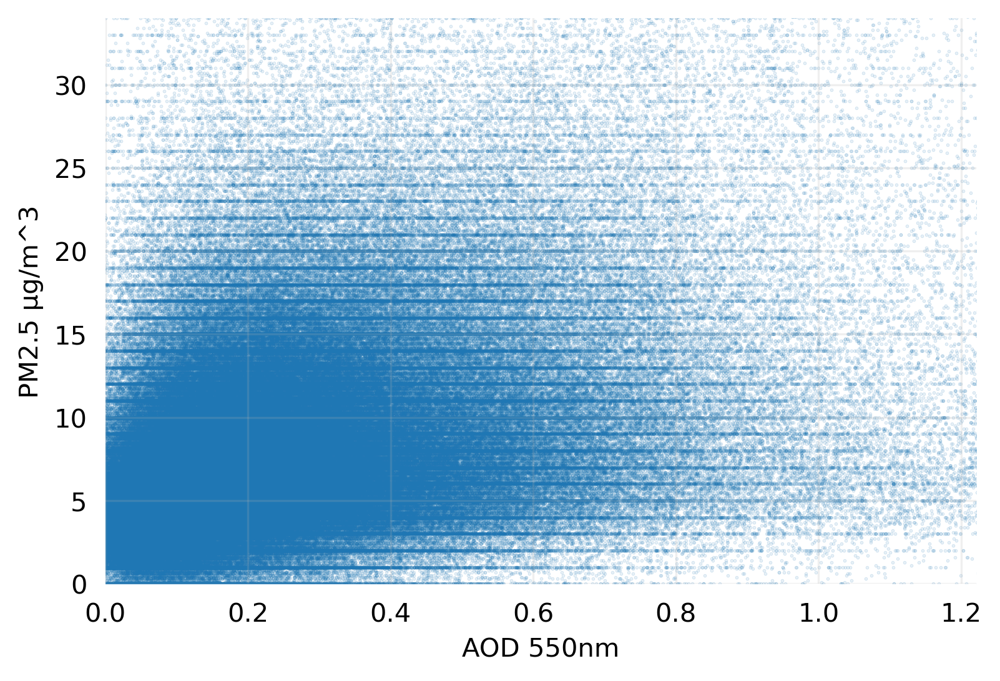

In [447]:
fig, ax = plt.subplots(dpi=300)

# mappable = ax.hexbin(df.AOD, df.sample_measurement, gridsize=1000)
# fig.colorbar(mappable)

y = matched.sample_measurement
x = matched.AOD
ax.scatter(x, y, s=0.1, alpha=0.2)

ax.set_xlim((0, np.percentile(x, 99)))
ax.set_ylim((0, np.percentile(y, 99)))

ax.set_xlabel('AOD 550nm')
ax.set_ylabel('PM2.5 µg/m^3')

ax.tick_params(width=0)
ax.grid(alpha=0.2)
for spine in ['top', 'left', 'bottom', 'right']:
    ax.spines[spine].set_visible(False)

<AxesSubplot:xlabel='AOD', ylabel='sample_measurement'>

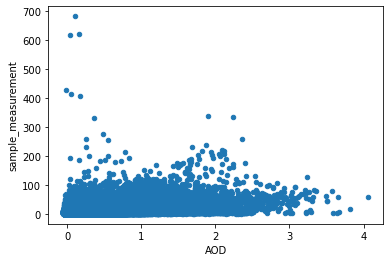

In [448]:
matched[~matched.sample_measurement.isin(np.arange(0, 35, 1))].plot.scatter(x='AOD', y='sample_measurement')

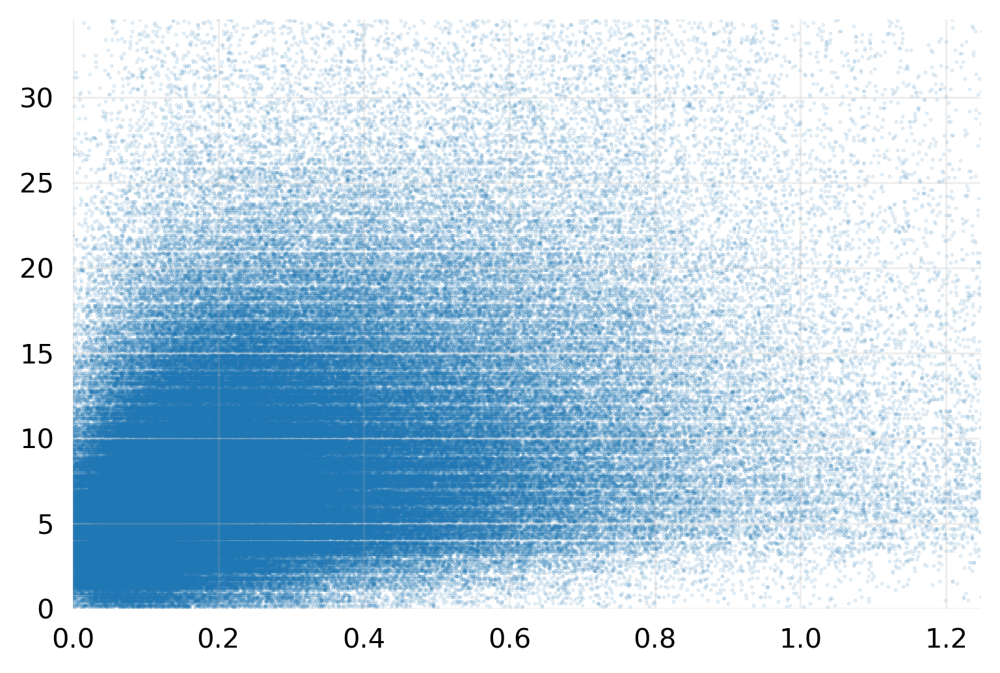

In [449]:
fig, ax = plt.subplots(dpi=300)

# mappable = ax.hexbin(df.AOD, df.sample_measurement, gridsize=1000)
# fig.colorbar(mappable)

sub = matched[~matched.sample_measurement.isin(np.arange(0, int(matched.sample_measurement.max()), 1))]

y = sub.sample_measurement
x = sub.AOD
ax.scatter(x, y, s=0.1, alpha=0.2)

ax.set_xlim((0, np.percentile(x, 99)))
ax.set_ylim((0, np.percentile(y, 99)))

ax.tick_params(width=0)
ax.grid(alpha=0.2)
for spine in ['top', 'left', 'bottom', 'right']:
    ax.spines[spine].set_visible(False)

In [450]:
matched[matched.sample_measurement.isin(np.arange(0, int(matched.sample_measurement.max()), 1))]

,Unnamed: 0,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
0,4590,2021-01-01 13:00:00+00:00,42.770837,-71.102290,5.0,Micrograms/cubic meter (LC),3,HOURLY,3.023046e+05,4.095499e+06,0.048341
1,4599,2021-01-01 13:00:00+00:00,42.245865,-70.962766,4.0,Micrograms/cubic meter (LC),3,HOURLY,3.161002e+05,4.059124e+06,0.006947
3,4612,2021-01-01 13:00:00+00:00,42.452299,-73.239648,13.0,Micrograms/cubic meter (LC),3,HOURLY,1.374452e+05,4.074471e+06,0.064665
5,4671,2021-01-01 13:00:00+00:00,41.841039,-71.360970,16.0,Micrograms/cubic meter (LC),3,HOURLY,2.870554e+05,4.031061e+06,0.071755
6,4672,2021-01-01 13:00:00+00:00,42.612085,-71.306986,7.0,Micrograms/cubic meter (LC),3,HOURLY,2.872921e+05,4.084694e+06,0.034843
...,...,...,...,...,...,...,...,...,...,...,...
668983,5925049,2021-12-31 22:00:00+00:00,29.162997,-98.589158,21.0,Micrograms/cubic meter (LC),1,HOURLY,-2.144143e+06,2.976924e+06,0.173528
668986,5925273,2021-12-31 22:00:00+00:00,27.804489,-97.431553,24.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,0.710736
668988,5925356,2021-12-31 22:00:00+00:00,29.529432,-98.391403,15.0,Micrograms/cubic meter (LC),2,HOURLY,-2.118876e+06,3.010019e+06,0.295460
668989,5925370,2021-12-31 22:00:00+00:00,33.999580,-117.416010,2.0,Micrograms/cubic meter (LC),9,HOURLY,-3.316039e+06,3.307956e+06,0.109456


In [75]:
df = df.reset_index()

In [76]:
lat, lon = 27.804489, -97.431553
thing2 = df[(df.longitude == lon) & (df.latitude == lat)]

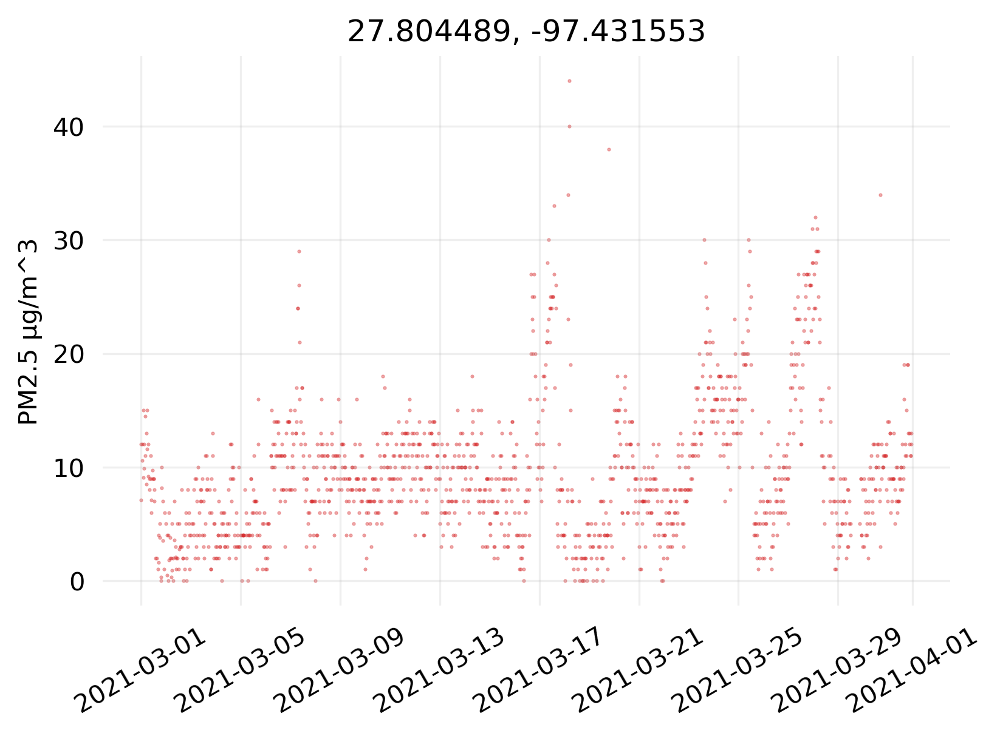

In [80]:
fig, ax = plt.subplots(dpi=300)
    
sub = thing2.set_index('time')
sub = sub.loc['2021-03-01':'2021-03-31', ['AOD', 'sample_measurement']]

ax.scatter(sub.index, sub.sample_measurement,
    lw=1, alpha=0.5,
    color='tab:red',
    s=0.2
)

ax.set_title(f'{lat}, {lon}')
ax.grid(alpha=0.2)
ax.tick_params(width=0)
ax.tick_params(axis='x', labelrotation = 30)
ax.set_ylabel('PM2.5 µg/m^3')
for spine in ['top', 'bottom', 'left', 'right']:
    ax.spines[spine].set_visible(False)

In [69]:
lat, lon = 27.804489, -97.431553
thing = matched[(matched.longitude == lon) & (matched.latitude == lat)]

In [99]:
sub

,AOD,sample_measurement
time,,
2021-03-02 21:00:00+00:00,0.480481,3.0
2021-03-02 21:00:00+00:00,0.480481,8.0
2021-03-02 22:00:00+00:00,0.325359,6.0
2021-03-02 22:00:00+00:00,0.325359,5.0
2021-03-02 23:00:00+00:00,0.298003,1.0
2021-03-02 23:00:00+00:00,0.298003,4.0
2021-03-03 14:00:00+00:00,0.901357,5.0
2021-03-03 14:00:00+00:00,0.901357,11.0
2021-03-04 13:00:00+00:00,1.066291,5.0


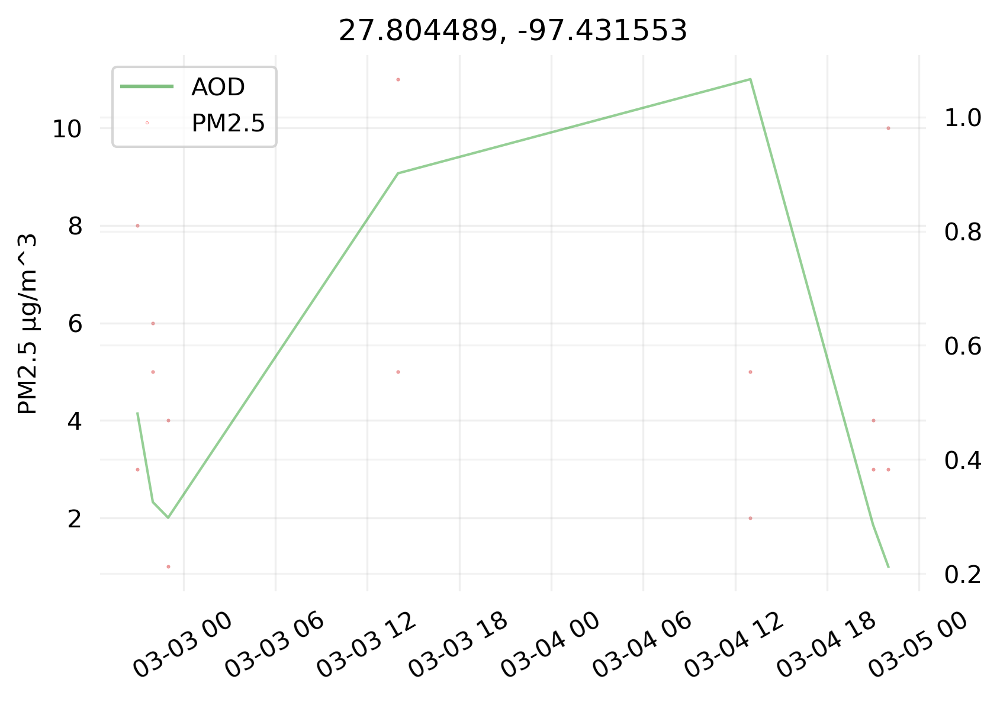

In [98]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(dpi=300)
    
ax2 = ax.twinx()
sub = thing.set_index('time')
sub = sub.loc['2021-03-02':'2021-03-04', ['AOD', 'sample_measurement']]

ax.scatter(sub.index, sub.sample_measurement,
    lw=1, alpha=0.5,
    color='tab:red',
    s=0.2
)
ax2.plot(sub.index, sub.AOD,
    lw=1, alpha=0.5,
    color='tab:green',
)

ax.set_title(f'{lat}, {lon}')
ax.grid(alpha=0.2)
ax.tick_params(width=0)
ax2.tick_params(width=0)
ax.tick_params(axis='x', labelrotation = 30)
ax.set_ylabel('PM2.5 µg/m^3')
ax2.grid('--', alpha=0.15)
for spine in ['top', 'bottom', 'left', 'right']:
    ax.spines[spine].set_visible(False)
    ax2.spines[spine].set_visible(False)
    
custom_lines = [Line2D([], [], color='green', alpha=0.5),
                Line2D([], [], marker='o', color='red', alpha=0.5, linestyle='None', markersize=0.2)]

ax2.legend(custom_lines, ['AOD', 'PM2.5'], loc='upper left', frameon=True, markerscale=1)

In [90]:
thing.set_index('time')[['sample_measurement', 'AOD']]

,sample_measurement,AOD
time,,
2021-01-02 14:00:00+00:00,1.0,1.177423
2021-01-02 19:00:00+00:00,3.0,0.540280
2021-01-02 19:00:00+00:00,0.0,0.540280
2021-01-02 20:00:00+00:00,0.0,0.408032
2021-01-02 20:00:00+00:00,3.0,0.408032
...,...,...
2021-12-30 21:00:00+00:00,19.0,0.452919
2021-12-31 21:00:00+00:00,19.0,0.584635
2021-12-31 21:00:00+00:00,19.0,0.584635


In [82]:
thing2

,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
367,2021-01-01 06:00:00+00:00,27.804489,-97.431553,3.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,NaN
390,2021-01-01 06:00:00+00:00,27.804489,-97.431553,2.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
1020,2021-01-01 07:00:00+00:00,27.804489,-97.431553,2.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,NaN
1120,2021-01-01 07:00:00+00:00,27.804489,-97.431553,0.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
1497,2021-01-01 08:00:00+00:00,27.804489,-97.431553,0.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
...,...,...,...,...,...,...,...,...,...,...
5928648,2022-01-01 03:00:00+00:00,27.804489,-97.431553,13.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
5929247,2022-01-01 04:00:00+00:00,27.804489,-97.431553,21.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
5929441,2022-01-01 04:00:00+00:00,27.804489,-97.431553,21.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,NaN
5929862,2022-01-01 05:00:00+00:00,27.804489,-97.431553,25.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN


In [86]:
thing[~thing.sample_measurement.isin(np.arange(0, thing.sample_measurement.max()+1, 1))]

,Unnamed: 0,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
370907,3382515,2021-07-30 21:00:00+00:00,27.804489,-97.431553,2.2,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.597227
371088,3383046,2021-07-30 22:00:00+00:00,27.804489,-97.431553,3.8,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.182204
646852,5607981,2021-12-12 19:00:00+00:00,27.804489,-97.431553,2.9,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.702904
647204,5608667,2021-12-12 20:00:00+00:00,27.804489,-97.431553,1.1,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.530108
647605,5609537,2021-12-12 21:00:00+00:00,27.804489,-97.431553,2.8,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.368693
647786,5610188,2021-12-12 22:00:00+00:00,27.804489,-97.431553,5.7,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.284575


In [87]:
thing2[~thing2.sample_measurement.isin(np.arange(0, thing2.sample_measurement.max()+1, 1))]

,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
906201,2021-02-27 05:00:00+00:00,27.804489,-97.431553,9.8,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
906802,2021-02-27 06:00:00+00:00,27.804489,-97.431553,16.4,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
907740,2021-02-27 07:00:00+00:00,27.804489,-97.431553,9.6,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
908652,2021-02-27 08:00:00+00:00,27.804489,-97.431553,6.2,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
908781,2021-02-27 09:00:00+00:00,27.804489,-97.431553,10.5,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
...,...,...,...,...,...,...,...,...,...,...
5617934,2021-12-13 09:00:00+00:00,27.804489,-97.431553,2.2,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
5618615,2021-12-13 10:00:00+00:00,27.804489,-97.431553,2.9,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
5618843,2021-12-13 11:00:00+00:00,27.804489,-97.431553,4.8,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN
5619634,2021-12-13 12:00:00+00:00,27.804489,-97.431553,2.2,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,NaN


In [71]:
sub

,AOD,sample_measurement
time,,
2021-03-02 21:00:00+00:00,0.480481,3.0
2021-03-02 21:00:00+00:00,0.480481,8.0
2021-03-02 22:00:00+00:00,0.325359,6.0
2021-03-02 22:00:00+00:00,0.325359,5.0
2021-03-02 23:00:00+00:00,0.298003,1.0
...,...,...
2021-03-30 21:00:00+00:00,0.526147,11.0
2021-03-30 22:00:00+00:00,0.301914,11.0
2021-03-30 22:00:00+00:00,0.301914,11.0


In [68]:
gdf.reset_index()[['time', 'AOD', 'sample_measurement']].groupby('time').count()

,AOD,sample_measurement
time,,
2021-04-04 22:00:00+00:00,1,1
2021-04-04 23:00:00+00:00,1,1
2021-04-05 12:00:00+00:00,1,1
2021-04-05 13:00:00+00:00,1,1
2021-04-05 14:00:00+00:00,1,1
...,...,...
2021-11-09 16:00:00+00:00,1,1
2021-11-09 17:00:00+00:00,1,1
2021-11-09 18:00:00+00:00,1,1


25.794222, -80.215556
26.053889, -80.256944
26.073536, -80.33845
26.132677, -80.169817
26.22621, -98.291069
26.291088, -80.096353
26.294167, -80.176389
26.456944, -80.092778
26.602016, -81.877908
26.687606, -80.219619
26.724786, -80.666447
27.290556, -82.507222
27.599444, -99.533333
27.785866, -82.739875
27.804489, -97.431553
27.946688, -82.731767
27.955133, -82.469532
27.96565, -82.2304
28.028889, -81.972222
28.053611, -80.628611
28.596389, -81.3625


/var/folders/j8/13gdnhs51_g_jl1wlxj7h3tm0000gn/T/ipykernel_48919/3666252831.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


28.704607, -100.451156
28.746111, -81.310556
29.162997, -98.589158
29.206667, -81.0525
29.275381, -98.311692
29.30265, -103.17781
29.51509, -98.620166
29.529432, -98.391403
29.566112, -82.26608
29.583047, -95.015544
29.670025, -95.128508
29.723333, -95.635833
29.767997, -95.220582
29.770698, -95.031232
29.81453, -95.38769
29.828086, -95.284096
29.863957, -94.317802
29.901036, -95.326137
29.922894, -93.909018
30.041238, -90.272826
30.135797, -81.633981
30.194167, -93.866944
30.262778, -81.606833
30.263204, -97.712891
30.300833, -89.395916
30.350302, -95.425128
30.35386, -97.69166
30.354944, -97.761803
30.378287, -88.53393
30.390369, -89.049778
30.461981, -91.179219
30.525367, -87.20355
30.628333, -96.362777
31.122419, -97.431052
31.169805, -81.495035
31.32389, -89.2922
31.337204, -110.936718
31.5776, -84.0998
31.765685, -106.455227
31.787885, -106.683324
31.870259, -102.334745
32.003712, -106.599715
32.090779, -81.130222
32.29515, -110.9823
32.322037, -106.768337
32.322661, -111.038389


41.657155, -85.968446
41.685707, -71.169235
41.69666, -86.214722
41.705226, -76.512726
41.771071, -88.152534
41.771444, -72.679923
41.784722, -72.631667
41.807469, -71.412968
41.821342, -73.297257
41.829495, -71.417457
41.841039, -71.36097
41.867331, -75.686219
41.876853, -103.656561
41.995568, -83.946559
42.060285, -87.863225
42.065106, -71.012129
42.09142, -77.20978
42.120229, -72.584503
42.139996, -87.799227
42.14175, -80.038611
42.19438, -72.555112
42.221442, -88.242207
42.22862, -83.2082
42.240565, -83.599602
42.241229, -70.963346
42.245865, -70.962766
42.261669, -83.157893
42.263955, -71.794322
42.267, -89.08917
42.278067, -85.54189
42.295824, -83.129431
42.298493, -72.334079
42.302786, -83.10653
42.312078, -83.103469
42.312158, -83.091943
42.3295, -71.0826
42.348873, -71.097163
42.385998, -83.266189
42.387222, -71.026111
42.388405, -82.979793
42.452299, -73.239648
42.474642, -70.970816
42.529999, -108.720003
42.605816, -72.596689
42.612085, -71.306986
42.64225, -73.75464
42.6930

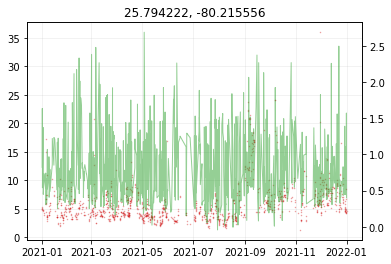

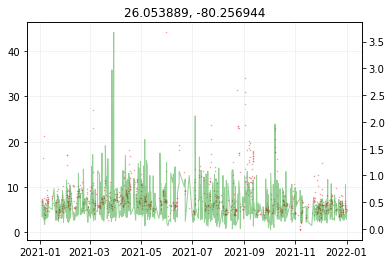

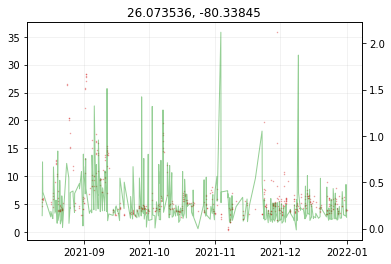

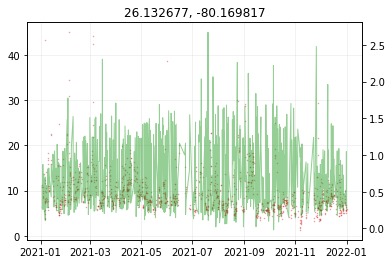

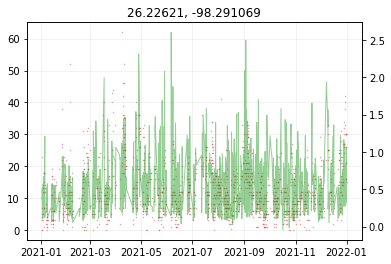

...

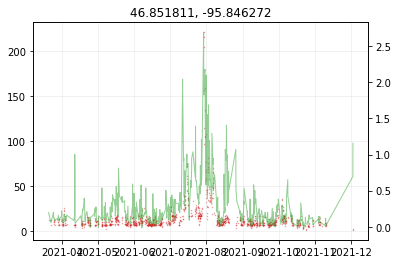

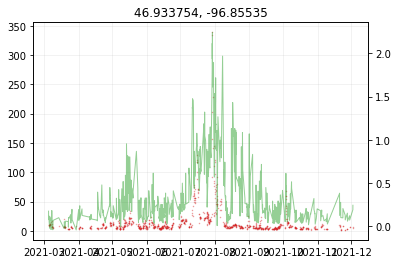

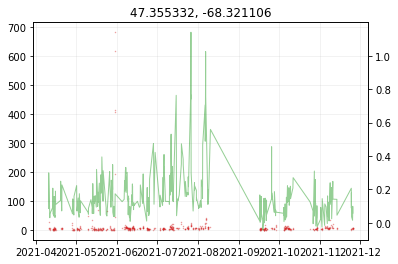

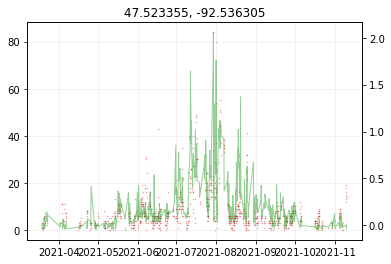

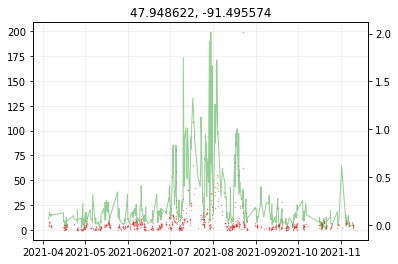

In [51]:
# x = 0
for (lat, lon), gdf in matched.groupby(['latitude', 'longitude']):
    fig, ax = plt.subplots()
    
    ax2 = ax.twinx()
    gdf = gdf.set_index('time')
    sub = gdf
#     sub = gdf.loc['2021-03-01':'2021-03-31', ['AOD', 'sample_measurement']]

    ax.scatter(sub.index, sub.sample_measurement,
        lw=1, alpha=0.5,
        color='tab:red',
        s=0.2
    )
    ax2.plot(sub.index, sub.AOD,
        lw=1, alpha=0.5,
        color='tab:green',
#         s=0.2
    )
    
#     ax.set_ylim((0, np.percentile(x, 99)))
#     ax2.set_ylim((0, np.percentile(sub.AOD, 99)))
    
    ax.set_title(f'{lat}, {lon}')
    ax.grid(alpha=0.2)
    print(f'{lat}, {lon}')
#     ax.tick_params(width=0)
#     ax2.tick_params(width=0)
#     ax.tick_params(axis='x', labelrotation = 30)
#     ax.set_ylabel('PM2.5 µg/m^3')
#     ax2.grid('--', alpha=0.15)
#     for spine in ['top', 'bottom', 'left', 'right']:
#         ax.spines[spine].set_visible(False)
#         ax2.spines[spine].set_visible(False)

In [88]:
a = pd.read_csv('/Users/kyle/Downloads/hourly_88101_2021.csv', parse_dates=[['Date GMT', 'Time GMT']])

/var/folders/j8/13gdnhs51_g_jl1wlxj7h3tm0000gn/T/ipykernel_15251/3849973949.py:1: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  a = pd.read_csv('/Users/kyle/Downloads/hourly_88101_2021.csv', parse_dates=[['Date GMT', 'Time GMT']])


In [89]:
a.columns.values

array(['Date GMT_Time GMT', 'State Code', 'County Code', 'Site Num',
       'Parameter Code', 'POC', 'Latitude', 'Longitude', 'Datum',
       'Parameter Name', 'Date Local', 'Time Local', 'Sample Measurement',
       'Units of Measure', 'MDL', 'Uncertainty', 'Qualifier',
       'Method Type', 'Method Code', 'Method Name', 'State Name',
       'County Name', 'Date of Last Change'], dtype=object)

In [90]:
a

,Date GMT_Time GMT,State Code,County Code,Site Num,Parameter Code,POC,Latitude,Longitude,Datum,Parameter Name,...,Units of Measure,MDL,Uncertainty,Qualifier,Method Type,Method Code,Method Name,State Name,County Name,Date of Last Change
0,2021-12-07 21:00:00,1,55,10,88101,3,33.991494,-85.992647,NAD83,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,209,Met One BAM-1022 Mass Monitor w/ VSCC or TE-PM...,Alabama,Etowah,2022-02-24
1,2021-12-07 22:00:00,1,55,10,88101,3,33.991494,-85.992647,NAD83,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,209,Met One BAM-1022 Mass Monitor w/ VSCC or TE-PM...,Alabama,Etowah,2022-02-24
2,2021-12-07 23:00:00,1,55,10,88101,3,33.991494,-85.992647,NAD83,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,209,Met One BAM-1022 Mass Monitor w/ VSCC or TE-PM...,Alabama,Etowah,2022-02-24
3,2021-12-08 00:00:00,1,55,10,88101,3,33.991494,-85.992647,NAD83,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,209,Met One BAM-1022 Mass Monitor w/ VSCC or TE-PM...,Alabama,Etowah,2022-02-24
4,2021-12-08 01:00:00,1,55,10,88101,3,33.991494,-85.992647,NAD83,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,209,Met One BAM-1022 Mass Monitor w/ VSCC or TE-PM...,Alabama,Etowah,2022-02-24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6212515,2022-01-01 03:00:00,80,2,14,88101,3,32.633671,-115.504995,WGS84,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,170,Met One BAM-1020 Mass Monitor w/VSCC - Beta At...,Country Of Mexico,BAJA CALIFORNIA NORTE,2022-01-13
6212516,2022-01-01 04:00:00,80,2,14,88101,3,32.633671,-115.504995,WGS84,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,170,Met One BAM-1020 Mass Monitor w/VSCC - Beta At...,Country Of Mexico,BAJA CALIFORNIA NORTE,2022-01-13
6212517,2022-01-01 05:00:00,80,2,14,88101,3,32.633671,-115.504995,WGS84,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,170,Met One BAM-1020 Mass Monitor w/VSCC - Beta At...,Country Of Mexico,BAJA CALIFORNIA NORTE,2022-01-13
6212518,2022-01-01 06:00:00,80,2,14,88101,3,32.633671,-115.504995,WGS84,PM2.5 - Local Conditions,...,Micrograms/cubic meter (LC),5.0,NaN,NaN,FEM,170,Met One BAM-1020 Mass Monitor w/VSCC - Beta At...,Country Of Mexico,BAJA CALIFORNIA NORTE,2022-01-13


In [93]:
a[a['Sample Measurement'].isin(np.arange(0, int(a['Sample Measurement'].max()), 1))].shape

(2769003, 23)

In [94]:
a.shape

(6212520, 23)

In [95]:
lat, lon = 27.804489, -97.431553
thing3 = a[(a.Longitude == lon) & (a.Latitude == lat)]

In [97]:
thing3 = thing3[['Date GMT_Time GMT', 'POC', 'Sample Measurement']]
thing3 = thing3[thing3['Sample Measurement'] >= 0]

In [98]:
thing3

,Date GMT_Time GMT,POC,Sample Measurement
5345751,2021-01-01 06:00:00,3,2.0
5345752,2021-01-01 07:00:00,3,0.0
5345753,2021-01-01 08:00:00,3,0.0
5345758,2021-01-01 13:00:00,3,2.0
5345759,2021-01-01 14:00:00,3,0.0
...,...,...,...
5362578,2022-01-01 01:00:00,4,22.0
5362579,2022-01-01 02:00:00,4,18.0
5362580,2022-01-01 03:00:00,4,15.0
5362581,2022-01-01 04:00:00,4,21.0


In [107]:
unique, counts = np.unique(thing3['Sample Measurement'].values, return_counts=True)

In [120]:
print(pd.DataFrame({'values': unique, 'count': counts}).to_string())

     values  count
0       0.0    361
1       0.3      2
2       0.5      1
3       0.9      3
4       1.0    539
5       1.1      1
6       1.4      1
7       1.6      1
8       1.7      1
9       1.8      2
10      1.9      1
11      2.0    819
12      2.1      2
13      2.2      3
14      2.3      1
15      2.8      2
16      2.9      2
17      3.0   1071
18      3.2      2
19      3.4      2
20      3.5      2
21      3.6      1
22      3.8      3
23      4.0   1281
24      4.3      1
25      4.4      2
26      4.8      1
27      4.9      1
28      5.0   1296
29      5.1      1
30      5.2      1
31      5.4      3
32      5.5      1
33      5.6      2
34      5.7      2
35      5.8      1
36      5.9      1
37      6.0   1348
38      6.2      2
39      6.6      1
40      6.7      1
41      6.9      1
42      7.0   1307
43      7.1      2
44      7.3      1
45      7.4      1
46      7.6      1
47      7.9      1
48      8.0   1143
49      8.2      3
50      8.4      1
51      8.5 

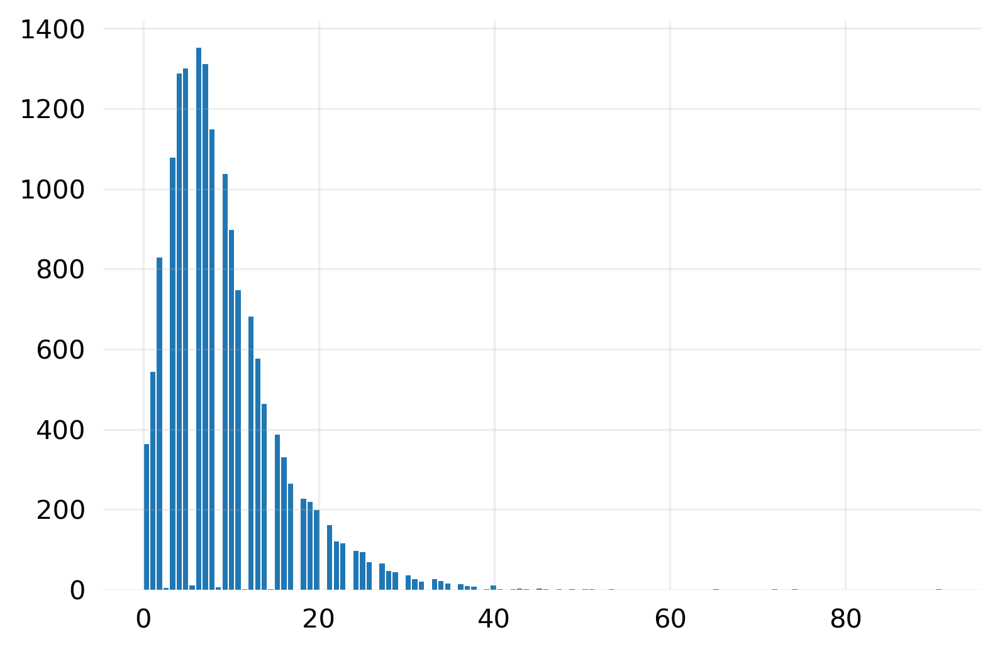

In [123]:
fig, ax = plt.subplots(dpi=300)

thing3['Sample Measurement'].hist(rwidth=0.8, bins=122, ax=ax)

ax.grid(alpha=0.2)

ax.tick_params(width=0)
for spine in ['top', 'left', 'bottom', 'right']:
    ax.spines[spine].set_visible(False)

In [120]:
thing3

,Date GMT_Time GMT,POC,Sample Measurement
5345751,2021-01-01 06:00:00,3,2.0
5345752,2021-01-01 07:00:00,3,0.0
5345753,2021-01-01 08:00:00,3,0.0
5345758,2021-01-01 13:00:00,3,2.0
5345759,2021-01-01 14:00:00,3,0.0
...,...,...,...
5362578,2022-01-01 01:00:00,4,22.0
5362579,2022-01-01 02:00:00,4,18.0
5362580,2022-01-01 03:00:00,4,15.0
5362581,2022-01-01 04:00:00,4,21.0


In [122]:
thing3['Date GMT_Time GMT'].values

array(['2021-01-01T06:00:00.000000000', '2021-01-01T07:00:00.000000000',
       '2021-01-01T08:00:00.000000000', ...,
       '2022-01-01T03:00:00.000000000', '2022-01-01T04:00:00.000000000',
       '2022-01-01T05:00:00.000000000'], dtype='datetime64[ns]')

In [126]:
dates = list(set(thing.time.values).intersection(set(thing3['Date GMT_Time GMT'].values)))

In [131]:
len(dates)

1040

In [133]:
thing

,Unnamed: 0,time,latitude,longitude,sample_measurement,units_of_measure,poc,sample_frequency,proj_longitude,proj_latitude,AOD
546,21104,2021-01-02 14:00:00+00:00,27.804489,-97.431553,1.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,1.177423
811,24362,2021-01-02 19:00:00+00:00,27.804489,-97.431553,3.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,0.540280
823,24445,2021-01-02 19:00:00+00:00,27.804489,-97.431553,0.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.540280
897,25051,2021-01-02 20:00:00+00:00,27.804489,-97.431553,0.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,0.408032
920,25297,2021-01-02 20:00:00+00:00,27.804489,-97.431553,3.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.408032
...,...,...,...,...,...,...,...,...,...,...,...
668675,5907907,2021-12-30 21:00:00+00:00,27.804489,-97.431553,19.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.452919
668955,5924306,2021-12-31 21:00:00+00:00,27.804489,-97.431553,19.0,Micrograms/cubic meter (LC),4,HOURLY,-2.077743e+06,2.858452e+06,0.584635
668968,5924576,2021-12-31 21:00:00+00:00,27.804489,-97.431553,19.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.584635
668981,5924954,2021-12-31 22:00:00+00:00,27.804489,-97.431553,22.0,Micrograms/cubic meter (LC),3,HOURLY,-2.077743e+06,2.858452e+06,0.710736


In [135]:
thing.time

546      2021-01-02 14:00:00+00:00
811      2021-01-02 19:00:00+00:00
823      2021-01-02 19:00:00+00:00
897      2021-01-02 20:00:00+00:00
920      2021-01-02 20:00:00+00:00
                    ...           
668675   2021-12-30 21:00:00+00:00
668955   2021-12-31 21:00:00+00:00
668968   2021-12-31 21:00:00+00:00
668981   2021-12-31 22:00:00+00:00
668986   2021-12-31 22:00:00+00:00
Name: time, Length: 1985, dtype: datetime64[ns, UTC]